# Detectron2 Beginner's Tutorial -- AMMI 2023 CV Week 2 Lab 1

<img src="https://dl.fbaipublicfiles.com/detectron2/Detectron2-Logo-Horz.png" width="500">

Welcome to detectron2! This is the official colab tutorial of detectron2. Here, we will go through some basics usage of detectron2, including the following:
* Run inference on images or videos, with an existing detectron2 model
* Train a detectron2 model on a new dataset

You can make a copy of this tutorial by "File -> Open in playground mode" and make changes there. __DO NOT__ request access to this tutorial.


# Install detectron2

In [1]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities.
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 3.5 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
Cloning into 'detectron2'...
remote: Enumerating objects: 15671, done.
remote: Counting objects: 100% (394/394), done.
remote: Compressing objects: 100% (293/293), done.
remote: Total 15671 (delta 174), reused 274 (delta 101), pack-reused 15277
Receiving objects: 100% (15671/15671), 6.50 MiB | 7.92 MiB/s, done.
Resolving deltas: 100% (11290/11290), done.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.0 MB/s eta 0:00

In [2]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0
torch:  2.2 ; cuda:  cu121
detectron2: 0.6


In [3]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Run a pre-trained detectron2 model

We first download an image from the COCO dataset:

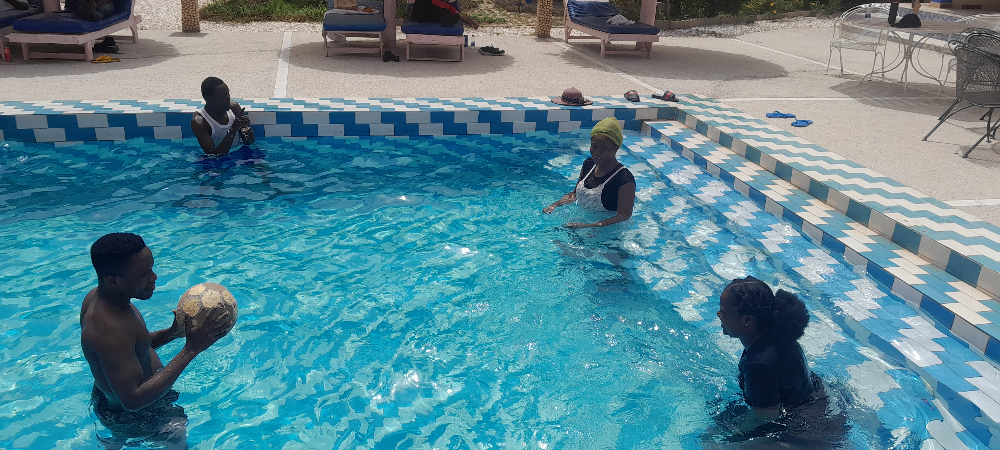

(1836, 4080, 3)


In [60]:
# !wget http://images.cocodataset.org/val2017/000000439715.jpg -q -O input.jpg
# !wget https://www.iainmasterton.com/img/pixel.gif -q -O input1.jpg
im = cv2.imread("./cv9.jpeg")
cv2_imshow(im)
print(im.shape)

Then, we create a detectron2 config and a detectron2 `DefaultPredictor` to run inference on this image.

In [61]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(im)

[05/06 15:59:04 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


In [62]:
# look at the outputs. See https://detectron2.readthedocs.io/tutorials/models.html#model-output-format for specification
print(outputs["instances"].pred_classes)
print(outputs["instances"].pred_boxes)

tensor([ 0,  0,  0,  0, 13, 56, 60, 35], device='cuda:0')
Boxes(tensor([[3.1968e+02, 9.3760e+02, 9.2822e+02, 1.8345e+03],
        [2.9183e+03, 1.1266e+03, 3.3776e+03, 1.7036e+03],
        [2.1936e+03, 4.7942e+02, 2.5890e+03, 9.3028e+02],
        [7.7597e+02, 3.1635e+02, 1.0610e+03, 6.4432e+02],
        [2.2982e+03, 2.5893e+00, 2.6970e+03, 2.4347e+02],
        [3.7771e+03, 1.3543e+02, 4.0800e+03, 6.5076e+02],
        [3.4406e+03, 3.6557e+01, 4.0325e+03, 4.2239e+02],
        [7.2040e+02, 1.1469e+03, 9.7242e+02, 1.4156e+03]], device='cuda:0'))


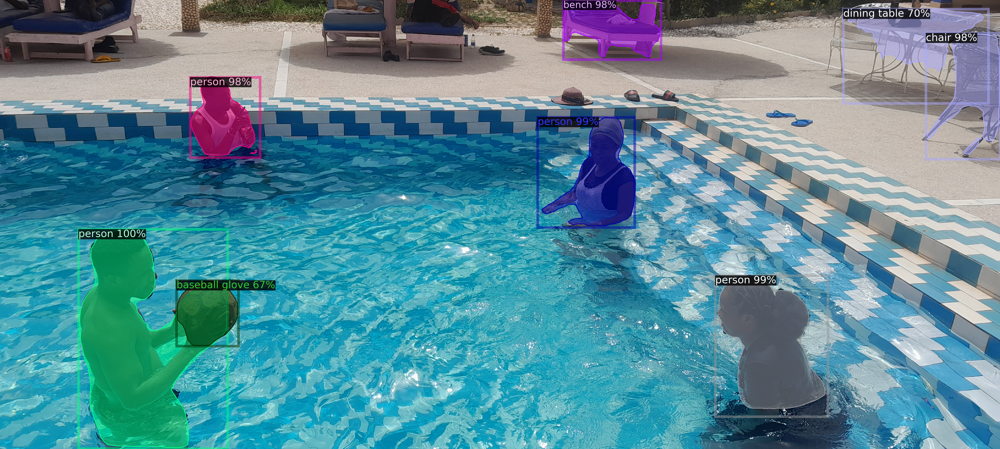

In [63]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

# Human pose estimation

[05/06 16:11:57 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_C4_1x/137259246/model_final_9243eb.pkl ...


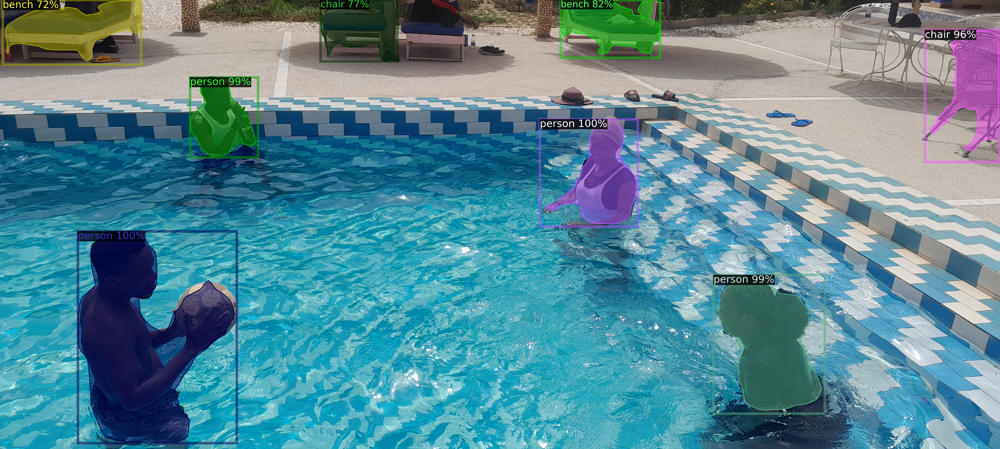

In [66]:
# Inference with a keypoint detection model
cfg = get_cfg()   # get a fresh new config

# Navigate to the Detectron2 Model Zoo and figure out a suitable model yaml configuration
# file to use. Follow the example above as a template.
# Model Zoo: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md
# List = ['COCO-InstanceSegmentation/mask_rcnn_R_101_C4_3x.yaml', 'COCO-InstanceSegmentation/mask_rcnn_R_101_DC5_3x.yaml',
#         # 'COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml',
#         'COCO-InstanceSegmentation/mask_rcnn_R_50_C4_1x.yaml', 'COCO-InstanceSegmentation/mask_rcnn_R_50_C4_3x.yaml',
#         'COCO-InstanceSegmentation/mask_rcnn_R_50_DC5_1x.yaml', 'COCO-InstanceSegmentation/mask_rcnn_R_50_DC5_3x.yaml',
#         'COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_1x.yaml', 'COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml']

# for name in List:
CONFIG_FILE = 'COCO-InstanceSegmentation/mask_rcnn_R_101_C4_3x.yaml'

cfg.merge_from_file(model_zoo.get_config_file(CONFIG_FILE))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7  # set threshold for this model
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(CONFIG_FILE)
predictor = DefaultPredictor(cfg)
outputs = predictor(im)
v = Visualizer(im[:,:,::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])